# Clustering & Spatial Domain Detection

Identify transcriptionally distinct clusters and map them back to tissue morphology. Discover spatial domains that correspond to known breast cancer histological regions.

In [17]:
# IMPORTS & PATHS 

from __future__ import annotations
from pathlib import Path
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import tempfile

# Workaround for Windows Store Python + numba caching: use a writable cache dir
os.environ.setdefault('NUMBA_CACHE_DIR', str(Path(tempfile.gettempdir()) / 'numba_cache'))
Path(os.environ['NUMBA_CACHE_DIR']).mkdir(parents=True, exist_ok=True)

import scanpy as sc
import squidpy as sq

# Make saved PNGs readable in viewers (no transparency / white background)
sc.settings.set_figure_params(dpi=120, facecolor='white', transparent=False)
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['savefig.facecolor'] = 'white'
plt.rcParams['savefig.transparent'] = False


sc.settings.verbosity = 3

# Project Root
cwd = Path.cwd().resolve()
if (cwd / 'README.md').exists() and (cwd / 'data').exists():
    project_root = cwd
elif (cwd.parent / 'README.md').exists() and (cwd.parent / 'data').exists():
    project_root = cwd.parent
else:
    raise RuntimeError(f'Cannot locate project root from cwd={cwd}.')

raw_dir       = project_root / 'data' / 'raw'   / 'Visium_Human_Breast_Cancer'
processed_dir = project_root / 'data' / 'processed'
fig_qc_dir    = project_root / 'figures' / 'qc'
fig_sp_dir    = project_root / 'figures' / 'spatial'

for d in [processed_dir, fig_qc_dir, fig_sp_dir]:
    d.mkdir(parents=True, exist_ok=True)

sc.settings.figdir = str(fig_qc_dir)

print(f"Scanpy  : {sc.__version__}")
print(f"Squidpy : {sq.__version__}")
print(f"Raw dir : {raw_dir}")

Scanpy  : 1.12
Squidpy : 1.8.1
Raw dir : C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\data\raw\Visium_Human_Breast_Cancer


In [18]:
# LOAD PREPROCESSED ADATA 
adata = sc.read_h5ad(processed_dir / 'adata_preprocessed.h5ad')
print(adata)
print(f"Spots : {adata.n_obs:,}  Genes : {adata.n_vars:,}")
print(f"UMAP  : {adata.obsm['X_umap'].shape}")
print(f"Neighbors computed : {'neighbors' in adata.uns}")

AnnData object with n_obs × n_vars = 4869 × 21349
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_genes', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'neighbors', 'pca', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'
Spots : 4,869  Genes : 21,349
UMAP  : (4869, 2)
Neighbors computed : True


In [19]:
# LEIDEN CLUSTERING (MULTIPLE RESOLUTIONS) 
# We test 4 resolutions to find the best biological granularity
# Low  res (0.3) → fewer, broader clusters
# High res (1.0) → more, finer clusters

resolutions = [0.3, 0.5, 0.6, 1.0]

for res in resolutions:
    sc.tl.leiden(adata, resolution=res,
                 key_added=f'leiden_{res}',
                 random_state=42)
    n_cl = adata.obs[f'leiden_{res}'].nunique()
    print(f"  res={res:.1f}  →  {n_cl} clusters")

running Leiden clustering
    finished: found 6 clusters and added
    'leiden_0.3', the cluster labels (adata.obs, categorical) (0:00:00)
  res=0.3  →  6 clusters
running Leiden clustering
    finished: found 9 clusters and added
    'leiden_0.5', the cluster labels (adata.obs, categorical) (0:00:00)
  res=0.5  →  9 clusters
running Leiden clustering
    finished: found 10 clusters and added
    'leiden_0.6', the cluster labels (adata.obs, categorical) (0:00:00)
  res=0.6  →  10 clusters
running Leiden clustering
    finished: found 14 clusters and added
    'leiden_1.0', the cluster labels (adata.obs, categorical) (0:00:00)
  res=1.0  →  14 clusters


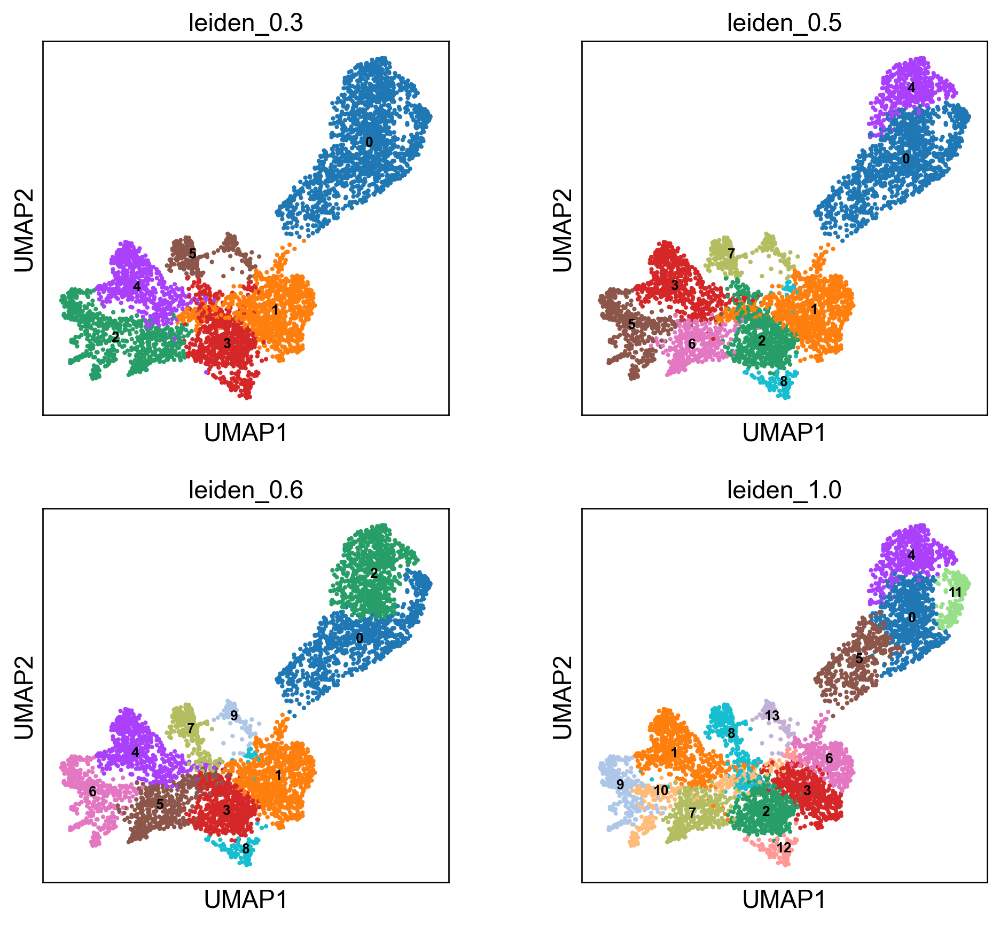

Saved → figures/clustering/umap_01_umap_resolutions.png


In [20]:
# UMAP — ALL RESOLUTIONS  
sc.pl.umap(
    adata,
    color=['leiden_0.3', 'leiden_0.5', 'leiden_0.6', 'leiden_1.0'],
    ncols=2,
    legend_loc='on data',
    legend_fontsize=8,
    save='_01_umap_resolutions.png'
)
print("Saved → figures/clustering/umap_01_umap_resolutions.png")

**Interpretation of spatial plots at different Leiden resolutions:**

- 0.3 is very coarse (big merged groups).
- 0.5 and 0.6 split the UMAP into more meaningful sub-islands without exploding into many tiny groups.
- 1.0 creates many smaller clusters (risk of over-splitting).

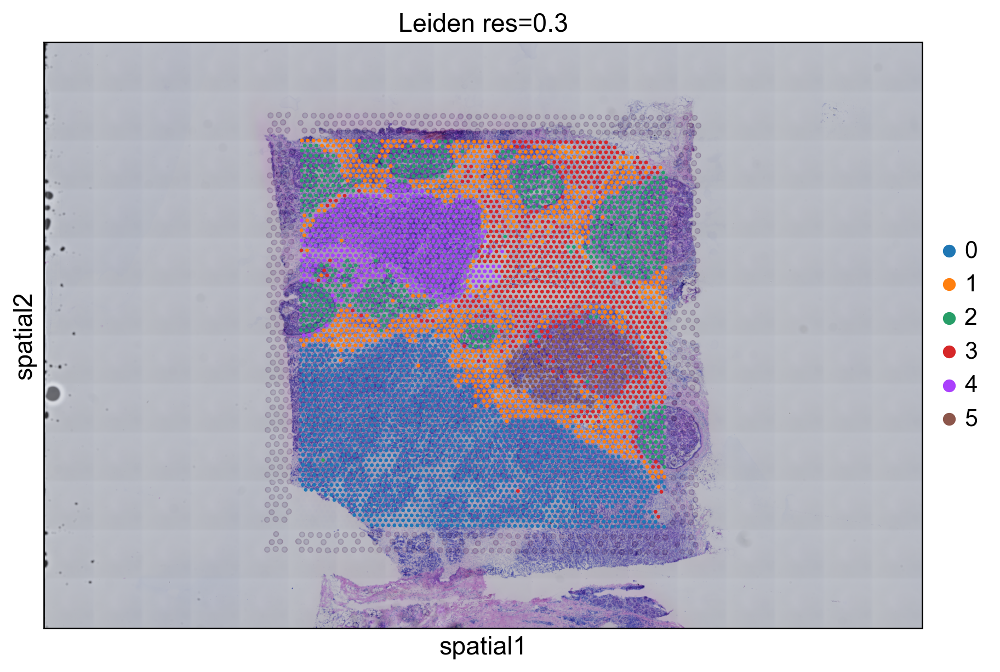

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\02_spatial_leiden_0.3.png


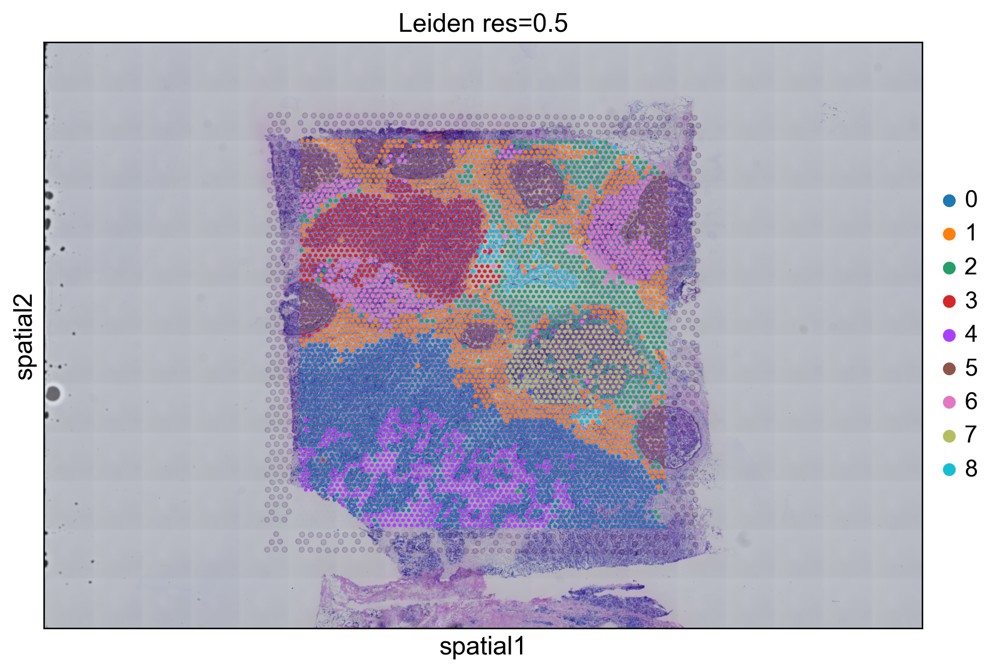

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\02_spatial_leiden_0.5.png


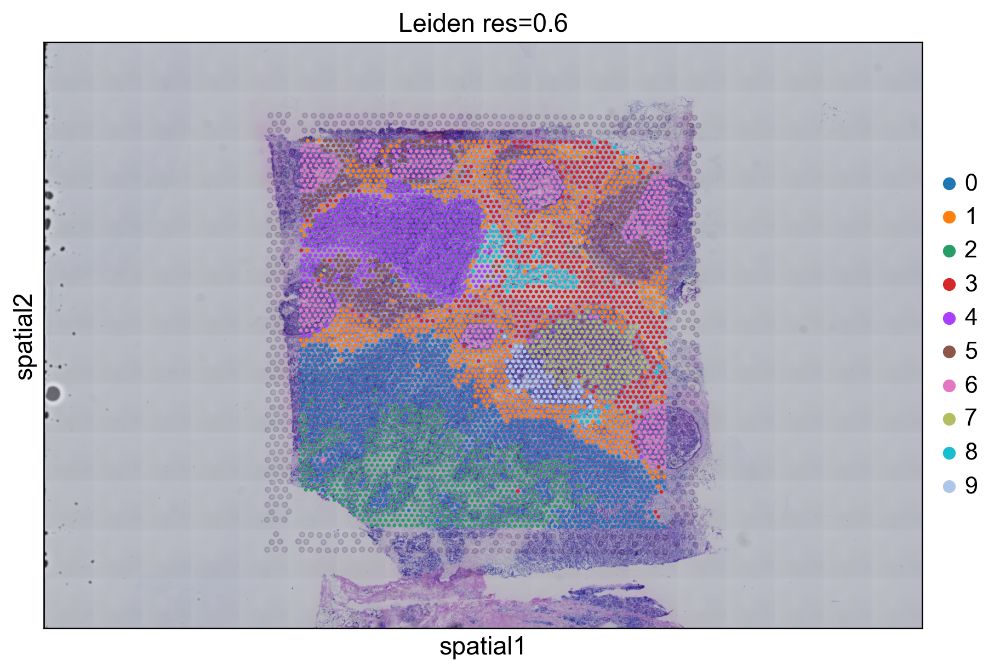

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\02_spatial_leiden_0.6.png


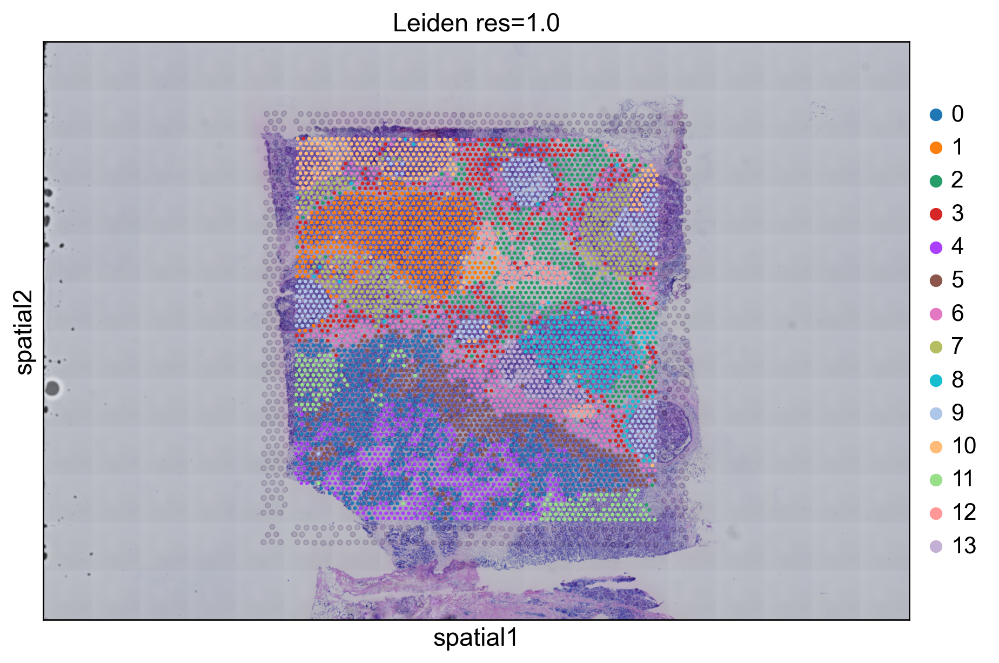

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\02_spatial_leiden_1.0.png


In [22]:
# SPATIAL SCATTER - CLUSTERS ON TISSUE
# Do clusters map to biological regions?

import matplotlib.pyplot as plt
from IPython.display import display

prev_figdir = sc.settings.figdir
sc.settings.figdir = str(fig_sp_dir)

for res in ['0.3', '0.5', '0.6', '1.0']:
    sq.pl.spatial_scatter(
        adata,
        color=f'leiden_{res}',
        title=f'Leiden res={res}',
        save=None,
    )

    fig = plt.gcf()
    fig.set_size_inches(14, 5)
    display(fig)

    out_path = fig_sp_dir / f'02_spatial_leiden_{res}.png'
    fig.savefig(out_path, dpi=200, facecolor='white', edgecolor='white', transparent=False, bbox_inches='tight')
    plt.close(fig)

    print(f'Saved -> {out_path}')

sc.settings.figdir = prev_figdir


**Interpretation of spatial plots at different Leiden resolutions:**

- **figures/spatial/02_spatial_leiden_0.3.png:**
  very clean big regions, but it’s a bit too coarse (likely merges multiple tissue programs).
- **figures/spatial/02_spatial_leiden_0.5.png:** 
  good balance—mostly contiguous domains with a few finer structures; not too “speckled”.
- **figures/spatial/02_spatial_leiden_0.6.png:** 
  starts to over-split some areas into smaller islands/patches (still usable, but more fragmentation).
- **figures/spatial/02_spatial_leiden_1.0.png:** 
  too fragmented/salt-and-pepper for domain-style interpretation.

In [23]:
# CHOOSE BEST RESOLUTION 
# After looking at the spatial plots above, pick the resolution
# that best matches tissue morphology (tumor vs stroma vs immune)

BEST_RES = 'leiden_0.5'   # updated after viewing spatial plots
adata.obs['leiden'] = adata.obs[BEST_RES].copy()

n_clusters = adata.obs['leiden'].nunique()
print(f"Working resolution : {BEST_RES}")
print(f"Number of clusters : {n_clusters}")
print(f"Cluster sizes:\n{adata.obs['leiden'].value_counts()}")

Working resolution : leiden_0.5
Number of clusters : 9
Cluster sizes:
leiden
0    1208
1     921
2     618
3     541
4     432
5     426
6     362
7     256
8     105
Name: count, dtype: int64


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)
Marker genes computed


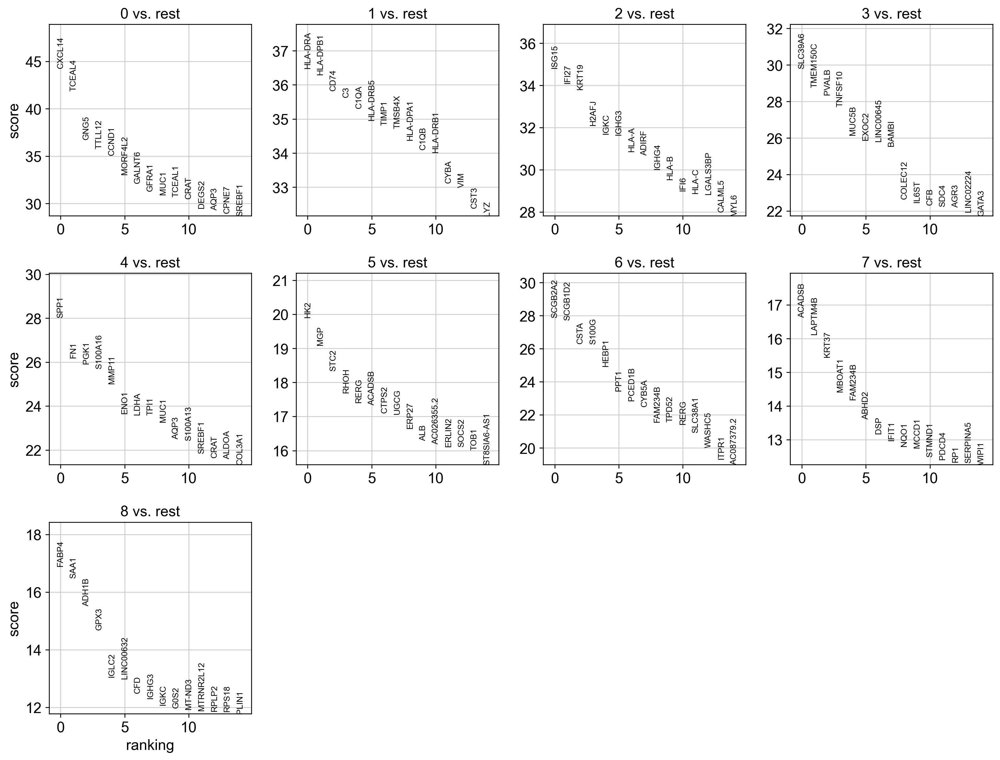

Saved → figures/clustering/rank_genes_groups_03_marker_genes.png


In [25]:
# MARKER GENES PER CLUSTER 
# Wilcoxon rank-sum test — most robust for single-cell/spatial data

sc.tl.rank_genes_groups(
    adata,
    groupby='leiden',
    method='wilcoxon',
    use_raw=True,       # use raw log-normalized counts
    pts=True            # calculate % of cells expressing each gene
)
print("Marker genes computed")

# Show top 15 markers per cluster
sc.pl.rank_genes_groups(
    adata, n_genes=15, sharey=False,
    save='_03_marker_genes.png'
)
print("Saved → figures/clustering/rank_genes_groups_03_marker_genes.png")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


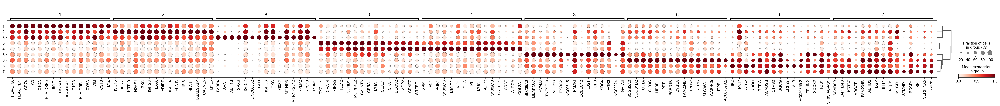

Saved → figures/markers/dotplot_04_dotplot_markers.png


In [26]:
# DOTPLOT — TOP MARKERS 
prev_figdir = sc.settings.figdir
sc.settings.figdir = str(fig_mk_dir)

sc.pl.rank_genes_groups_dotplot(
    adata,
    n_genes=15,
    standard_scale='var',
    save='_04_dotplot_markers.png'
)
print("Saved → figures/markers/dotplot_04_dotplot_markers.png")
sc.settings.figdir = prev_figdir

Markers found in dataset: ['EPCAM', 'ESR1', 'ERBB2', 'KRT5', 'VIM', 'COL1A1', 'CD68', 'CD3D', 'MKI67', 'PECAM1']


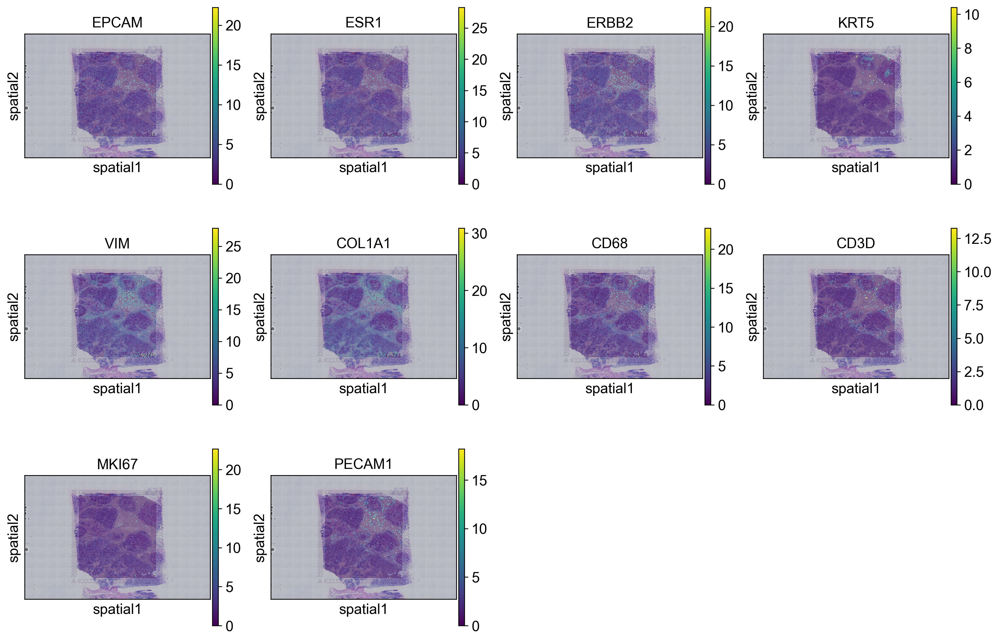

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\05_spatial_known_markers.png


In [28]:
# KNOWN BREAST CANCER MARKERS (SPATIAL)
# Visualize canonical markers on tissue to help annotate clusters

import matplotlib.pyplot as plt
from IPython.display import display

known_markers = [
    "EPCAM", "ESR1", "ERBB2", "KRT5", "VIM", "COL1A1",
    "CD68", "CD3D", "MKI67", "PECAM1",
]

markers_present = [g for g in known_markers if g in adata.var_names]
print(f"Markers found in dataset: {markers_present}")

if len(markers_present) == 0:
    raise RuntimeError("None of the known_markers were found in adata.var_names")

prev_figdir = sc.settings.figdir
sc.settings.figdir = str(fig_sp_dir)

sq.pl.spatial_scatter(
    adata,
    color=markers_present,
    ncols=4,
    use_raw=True,
    save=None,  # important: don't let squidpy save a transparent PNG
)

fig = plt.gcf()
fig.set_size_inches(16, 10)  # make it readable
display(fig)  # show in notebook

out_path = fig_sp_dir / "05_spatial_known_markers.png"
fig.savefig(out_path, dpi=200, facecolor="white", edgecolor="white", transparent=False, bbox_inches="tight")
plt.close(fig)

print(f"Saved -> {out_path}")

sc.settings.figdir = prev_figdir


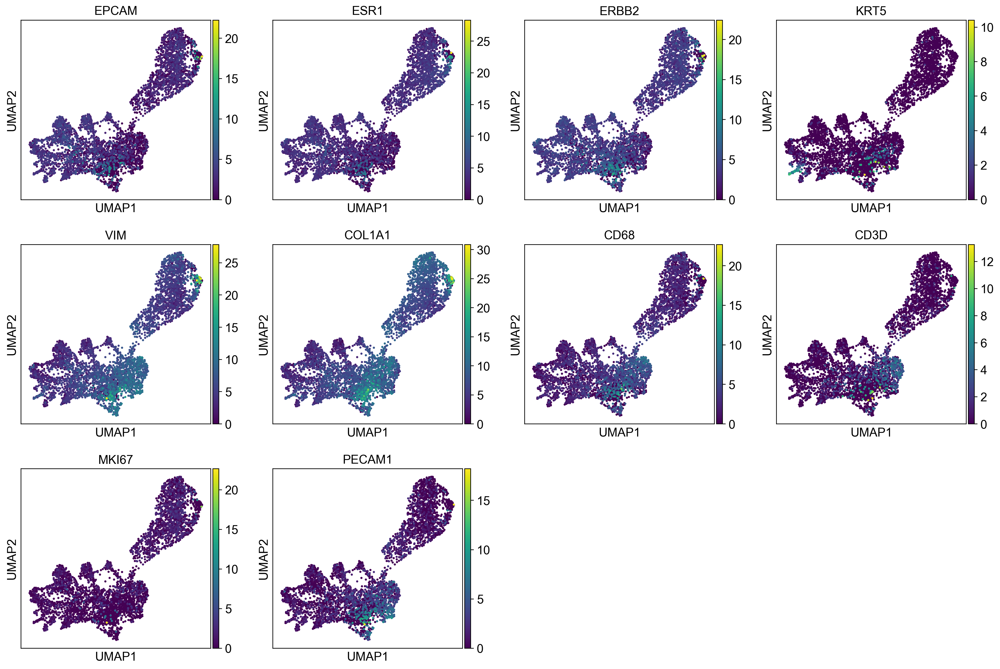

Saved → figures/clustering/umap_06_umap_known_markers.png


In [ ]:
# UMAP — KNOWN MARKERS 
sc.pl.umap(
    adata,
    color=markers_present,
    ncols=4,
    use_raw=True,
    save='_06_umap_known_markers.png'
)
print("Saved figures/clustering/umap_06_umap_known_markers.png")

In [30]:
# SAVE CLUSTERED ADATA 
out_path = processed_dir / 'adata_clustered.h5ad'
adata.write_h5ad(out_path)

print(f"   Saved → {out_path}")
print(f"   Shape : {adata.n_obs:,} spots × {adata.n_vars:,} genes")
print(f"   Size  : {out_path.stat().st_size / 1e6:.1f} MB")

   Saved → C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\data\processed\adata_clustered.h5ad
   Shape : 4,869 spots × 21,349 genes
   Size  : 1179.1 MB


In [31]:
# SUMMARY 
print('\n' + '=' * 55)
print('  NOTEBOOK 03 - CLUSTERING COMPLETE')
print('=' * 55)
print(f'  Resolution used  : {BEST_RES}')
print(f'  Clusters found   : {n_clusters}')
print(f'  Marker genes     : computed (adata.uns["rank_genes_groups"])')
print(f'  Saved to         : data/processed/adata_clustered.h5ad')
print('=' * 55)
print('\n→ Next: 04_Spatial_Analysis.ipynb')


  NOTEBOOK 03 - CLUSTERING COMPLETE
  Resolution used  : leiden_0.5
  Clusters found   : 9
  Marker genes     : computed (adata.uns["rank_genes_groups"])
  Saved to         : data/processed/adata_clustered.h5ad

→ Next: 04_Spatial_Analysis.ipynb
